## Support Vector Machine Classification 

Here we will use the Social Network Ads dataset in our project. We will try to classify based on some information about the user, if he/she have a probability of buying the item.

First, we will analyze the dataset and understand how the data is presented in this dataset. We will look for outliers and some statistical information.

Second, we will manipulate our data in order to prepare it for training the model we chose.

Third, we will train and test our model accuracy.

Importing the preprocessing and plotting libraries.

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import plot_confusion_matrix, accuracy_score

Import Dataset and analyse it:

In [7]:
data = pd.read_csv('Social_Network_Ads.csv')

In [3]:
data.head()

,User ID,Gender,Age,EstimatedSalary,Purchased
0,15624510,Male,19,19000,0
1,15810944,Male,35,20000,0
2,15668575,Female,26,43000,0
3,15603246,Female,27,57000,0
4,15804002,Male,19,76000,0


In [4]:
data.tail()

,User ID,Gender,Age,EstimatedSalary,Purchased
395,15691863,Female,46,41000,1
396,15706071,Male,51,23000,1
397,15654296,Female,50,20000,1
398,15755018,Male,36,33000,0
399,15594041,Female,49,36000,1


Building a function that displays a Pareto chart about our information:

Gráfico "User ID"


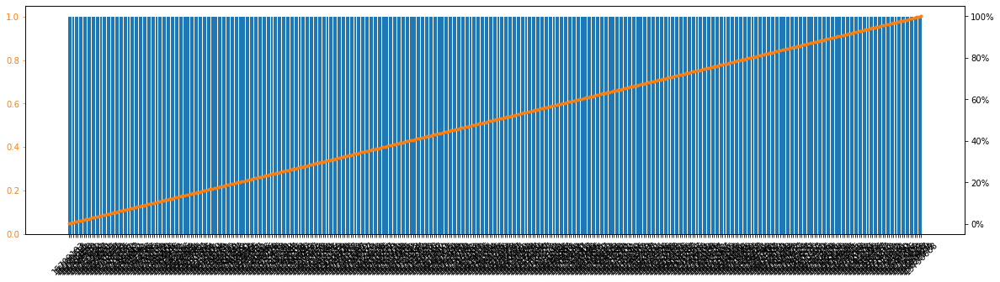

Gráfico "Gender"


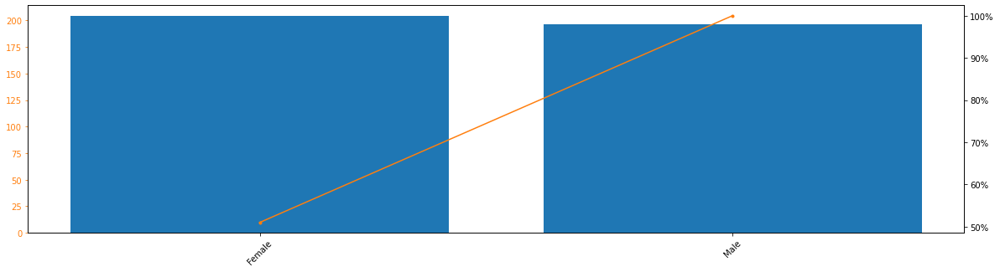

Gráfico "Age"


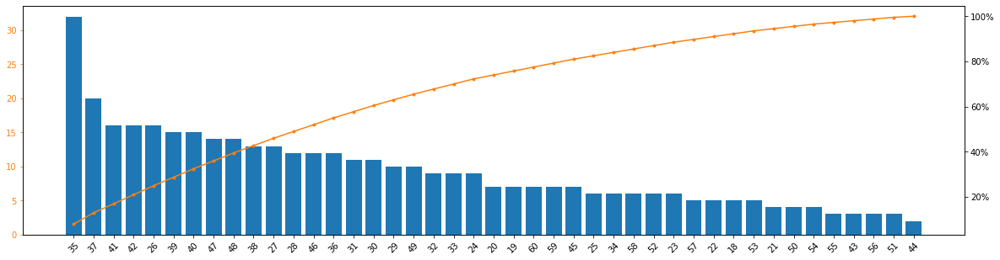

Gráfico "EstimatedSalary"


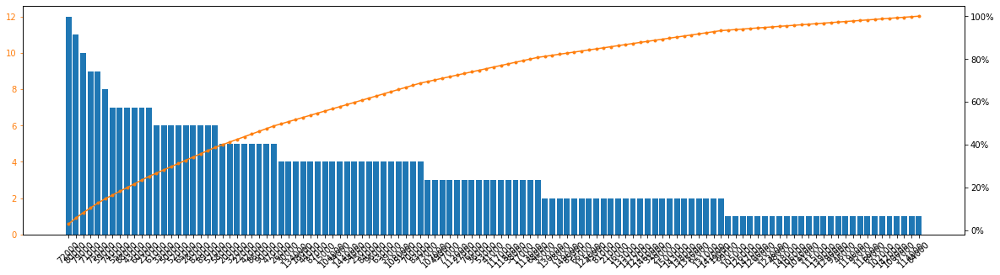

Gráfico "Purchased"


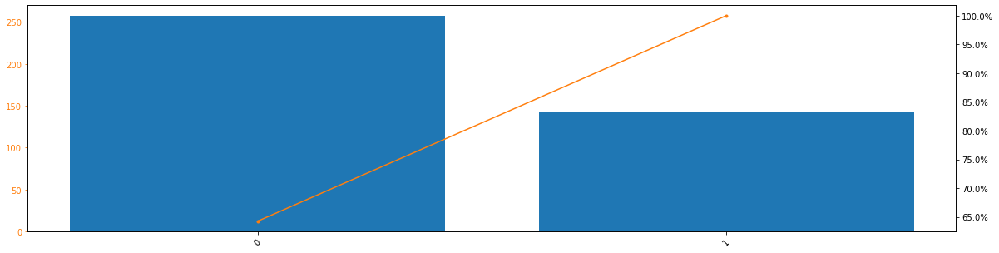

In [5]:
from matplotlib.ticker import PercentFormatter

def pareto_chart(df_, Column):
    """
    This function will receive the DataFrame to be analyzed and perform the calculations of pareto analisys on each label from the column received 
    """
    df = pd.DataFrame({Column:df_[Column].value_counts().index.astype(str).tolist(), 'Count':df_[Column].value_counts().tolist()})
    df['Percentage'] = df['Count'].cumsum()/df['Count'].sum()*100

    fig, ax = plt.subplots(figsize=(20,5))
    ax.bar(df[Column], df['Count'], color='C0')
    ax2 = ax.twinx()
    ax2.plot(df[Column], df['Percentage'], color='C1', marker=".")
    ax2.yaxis.set_major_formatter(PercentFormatter())

    ax.tick_params(axis="y", colors="C0")
    ax.tick_params(axis="y", colors="C1")

    for tick in ax.get_xticklabels():
        # Setting the X category angle of adjustment
        tick.set_rotation(45)
    plt.show()

for col in data.columns:
    print('Gráfico "{}"'.format(col))
    pareto_chart(df_=data, Column=col) 

In [6]:
data.describe()

,User ID,Age,EstimatedSalary,Purchased
count,4.000000e+02,400.000000,400.000000,400.000000
mean,1.569154e+07,37.655000,69742.500000,0.357500
std,7.165832e+04,10.482877,34096.960282,0.479864
min,1.556669e+07,18.000000,15000.000000,0.000000
25%,1.562676e+07,29.750000,43000.000000,0.000000
50%,1.569434e+07,37.000000,70000.000000,0.000000
75%,1.575036e+07,46.000000,88000.000000,1.000000
max,1.581524e+07,60.000000,150000.000000,1.000000


In the graphs plotted on cells above, we see that we don't have any distribution problem as unbalance classes, so we may continue the project.

Verifying missing data:

In [7]:
data.isnull().sum()

User ID            0
Gender             0
Age                0
EstimatedSalary    0
Purchased          0
dtype: int64

since the data doesn\`t have any missing value, we can continue the preprocessing fase:

Splitting the dataset into *Dependent* and *Independent Variables*.

In [8]:
X = data.iloc[:, 2:-1].values
Y = data.iloc[:, -1].values

print(f'Dependent Variables: \n{X[:5]} \n\nIndependen Variables: \n{Y[:5]}')

Dependent Variables: 
[[   19 19000]
 [   35 20000]
 [   26 43000]
 [   27 57000]
 [   19 76000]] 

Independen Variables: 
[0 0 0 0 0]


From the dependent and independent data, splitting it into training and test sets:

In [9]:
from sklearn.model_selection import train_test_split

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 0) 

As K Nearest Neighbors is an algorithm that uses euclidean distance, it\`s important for performance and accuracy porposes to apply feature scalling.

In [24]:
from sklearn.preprocessing import StandardScaler

ss_svm = StandardScaler()

X_train = ss_svm.fit_transform(X_train)
X_test = ss_svm.transform(X_test)

In [25]:
print(f'Training data after Standardizing: \n{X_train[:5]} \n\nTest Data after Standardizing: \n{X_test[:5]}')

Training data after Standardizing: 
[[ 1.92295008  2.14601566]
 [ 2.02016082  0.3787193 ]
 [-1.3822153  -0.4324987 ]
 [-1.18779381 -1.01194013]
 [ 1.92295008 -0.92502392]] 

Test Data after Standardizing: 
[[-0.79895082  0.49460758]
 [-0.02126485 -0.57735906]
 [-0.31289709  0.14694273]
 [-0.79895082  0.26283101]
 [-0.31289709 -0.57735906]]


## Training the SVM model with the training set

### Results Visualization Functions:

In [41]:
def confusion_matrix(classifier, xtrain, ytrain, xtest, ytest):

    #Setting the Confusion matrix objects:
    display = plot_confusion_matrix(classifier, xtrain, ytrain, normalize=None)
    display.ax_.set_title('Confusion Matrix')
    print(f'Model`s accuracy Score: \t{accuracy_score(ytest, classifier.predict(xtest))}')

In [42]:
def show_color_map_training(classifier, X_train, Y_train):
    # Creating color map
    from matplotlib.colors import ListedColormap

    cmap_light = ListedColormap(['orange', 'cyan', 'cornflowerblue'])
    cmap_bold = ListedColormap(['darkorange', 'c', 'darkblue'])

    X_set, y_set = ss_svm.inverse_transform(X_train), Y_train
    X1, X2 = np.meshgrid(np.arange(start = X_set[:, 0].min() - 10, stop = X_set[:, 0].max() + 10, step = 1),
                        np.arange(start = X_set[:, 1].min() - 1000, stop = X_set[:, 1].max() + 1000, step = 1))
    plt.contourf(X1, X2, classifier.predict(ss_svm.transform(np.array([X1.ravel(), X2.ravel()]).T)).reshape(X1.shape),
                alpha = 0.75, cmap = cmap_light)
    plt.xlim(X1.min(), X1.max())
    plt.ylim(X2.min(), X2.max())
    for i, j in enumerate(np.unique(y_set)):
        plt.scatter(X_set[y_set == j, 0], X_set[y_set == j, 1],
                    c = cmap_bold(i), label = j)
    plt.title('SVM (Training set)')
    plt.xlabel('Age')
    plt.ylabel('Estimated Salary')
    plt.legend()
    plt.show()

In [43]:
def show_color_map_classification(classifier, X_train, Y_train):
    # Creating color map
    from matplotlib.colors import ListedColormap

    cmap_light = ListedColormap(['orange', 'cyan', 'cornflowerblue'])
    cmap_bold = ListedColormap(['darkorange', 'c', 'darkblue'])

    # Creating the grid size:
    xmin, xmax = X_train[:, 0].min()-1, X_train[:, 0].max()+1 
    ymin, ymax = X_train[:, 1].min()-1, X_train[:, 1].max()+1

    # Creating a rectangular grid for the the view of decision borders:
    xx, yy = np.meshgrid(np.arange(xmin, xmax, 0.02),
                        np.arange(ymin, ymax, 0.02))

    # Transforming the rectangular matrix from mesh in one column for X and Y and concatenating in one matrix of 2 columns for prediction:
    Z = classifier.predict(np.c_[xx.ravel(), yy.ravel()])

    #Placing the result into a color plot
    Z = Z.reshape(xx.shape)

    plt.figure()
    plt.pcolormesh(xx, yy, Z, cmap=cmap_light)

    # plotting the data points on graphs:
    plt.scatter(X_train[:, 0], X_train[:, 1], c=Y_train, cmap=cmap_bold, edgecolors='k', s=20)
    plt.xlim(xx.min(), xx.max())
    plt.ylim(yy.min(), yy.max())
    plt.title('Classification')

    plt.show()

### Linear classification:

In [49]:
from sklearn.svm import SVC

linear_classifier = SVC(kernel = 'linear', random_state = 0)
linear_classifier.fit(X_train, Y_train)

non_linear_classifier = SVC(random_state = 0)
non_linear_classifier.fit(X_train, Y_train)

SVC(random_state=0)

## Visualizing results from svm linear kernel: 

Model`s accuracy Score: 	0.9125


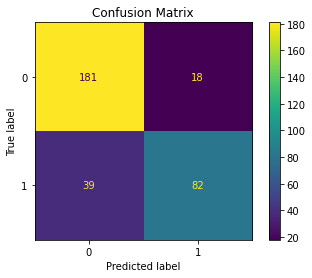

In [57]:
#Show Confusion matrix:
confusion_matrix(classifier=linear_classifier, xtrain=X_train, ytrain=Y_train, xtest=X_test, ytest=Y_test)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


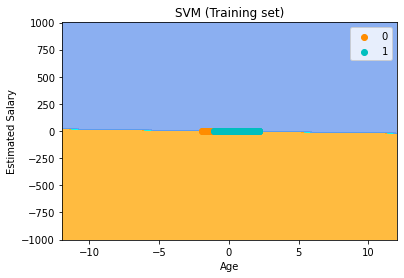

In [59]:
show_color_map_training(classifier=linear_classifier, X_train=X_train, Y_train=Y_train)

<ipython-input-43-057d6852c53c>:23: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=cmap_light)


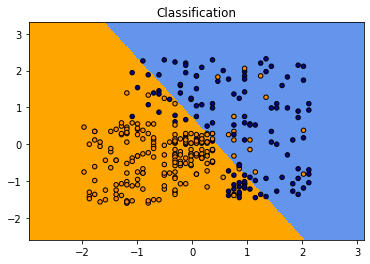

In [58]:
show_color_map_classification(classifier=linear_classifier, X_train=X_train, Y_train=Y_train)

### Visualizing results from a non linear kernel:

Model`s accuracy Score: 	0.95


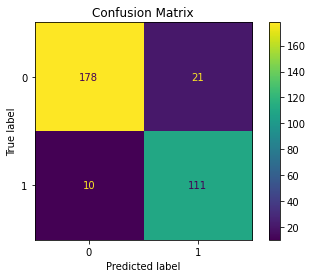

In [61]:
#Show Confusion matrix:
confusion_matrix(classifier=non_linear_classifier, xtrain=X_train, ytrain=Y_train, xtest=X_test, ytest=Y_test)

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


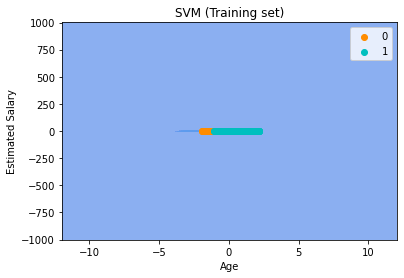

In [62]:
show_color_map_training(classifier=non_linear_classifier, X_train=X_train, Y_train=Y_train)

<ipython-input-43-057d6852c53c>:23: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=cmap_light)


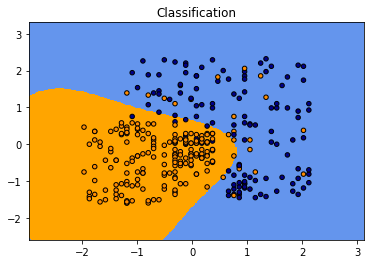

In [64]:
show_color_map_classification(classifier=non_linear_classifier, X_train=X_train, Y_train=Y_train)

# Results:

Based on both models (linear and non-linear)l, we can see that, the accuracy from linear kernel for SVM is lower than non-linear. This happens, as we can see on the classification plots, that the non-linear decision boundery shapes better on our data complexity.